## FRAUD DETECTION WITH KNN AND PCA

In [1]:
# IMPORT LIBRARIES
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
%matplotlib inline
from datetime import datetime, timedelta
import sklearn
from sklearn.impute import SimpleImputer
import plotly.express as px
from statsmodels.stats.outliers_influence import variance_inflation_factor    
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin
from sklearn.decomposition import PCA

#### INDEX

- Initial EDA
- Feature Engineering (Feature Creation)
- Insight Extraction from the features
- Anomaly Detection with KNN
- Anomaly Detection with PCA
- Results' Comparison (KNN vs PCA)

In [2]:
# Read the dataset
df = pd.read_csv('inpatientCharges.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163065 entries, 0 to 163064
Data columns (total 12 columns):
 #   Column                                Non-Null Count   Dtype 
---  ------                                --------------   ----- 
 0   DRG Definition                        163065 non-null  object
 1   Provider Id                           163065 non-null  int64 
 2   Provider Name                         163065 non-null  object
 3   Provider Street Address               163065 non-null  object
 4   Provider City                         163065 non-null  object
 5   Provider State                        163065 non-null  object
 6   Provider Zip Code                     163065 non-null  int64 
 7   Hospital Referral Region Description  163065 non-null  object
 8    Total Discharges                     163065 non-null  int64 
 9    Average Covered Charges              163065 non-null  object
 10   Average Total Payments               163065 non-null  object
 11  Average Medic

In [3]:
# Convert Average Payment to float and drop relatively lower important columns for the sake of simplicity
df['Avg_Payment']  = df[' Average Total Payments '].astype(str).str.split(r"\$", expand=True)[1].astype(float)
df['Avg_Medicare_Payment']  = df['Average Medicare Payments'].astype(str).str.split(r"\$", expand=True)[1].astype(float)
drops = ['Provider Street Address',' Average Covered Charges ',' Average Total Payments ','Provider Name','Hospital Referral Region Description','Average Medicare Payments']
df = df.drop(drops,axis=1)

In [4]:
# Imported zipcode median household income and merged with the file
# source : https://www.psc.isr.umich.edu/dis/census/Features/tract2zip/
df_zip = pd.read_csv('medianzip2.csv')
df = df.merge(df_zip,how='left',left_on='Provider Zip Code', right_on='Zip').rename(columns = {'Median_Income':'Med_Income_by_Zip'}).drop('Zip',axis=1)

In [5]:
# How many unique cities are there in the dataset?
df['Provider City'].nunique()

1977

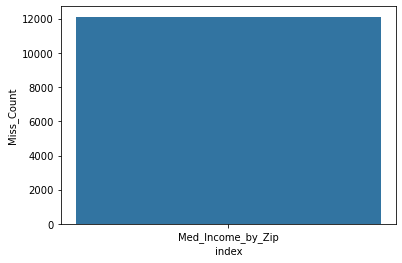

In [6]:
# Missing Value Detection
df_mis = pd.DataFrame(df.isnull().sum()).reset_index().sort_values(by=0,ascending=False).rename(columns={0:'Miss_Count'})
sns.barplot(x= 'index', y = 'Miss_Count', data = df_mis[df_mis['Miss_Count']>0])

In [7]:
# Missing Value Imputation with Median
median_impute = df.Med_Income_by_Zip.median()
df = df.fillna(median_impute)

In [8]:
df.head()

,DRG Definition,Provider Id,Provider City,Provider State,Provider Zip Code,Total Discharges,Avg_Payment,Avg_Medicare_Payment,Med_Income_by_Zip
0,039 - EXTRACRANIAL PROCEDURES W/O CC/MCC,10001,DOTHAN,AL,36301,91,5777.24,4763.73,38008.0
1,039 - EXTRACRANIAL PROCEDURES W/O CC/MCC,10005,BOAZ,AL,35957,14,5787.57,4976.71,33993.0
2,039 - EXTRACRANIAL PROCEDURES W/O CC/MCC,10006,FLORENCE,AL,35631,24,5434.95,4453.79,46652.0
3,039 - EXTRACRANIAL PROCEDURES W/O CC/MCC,10011,BIRMINGHAM,AL,35235,25,5417.56,4129.16,54491.0
4,039 - EXTRACRANIAL PROCEDURES W/O CC/MCC,10016,ALABASTER,AL,35007,18,5658.33,4851.44,66251.0


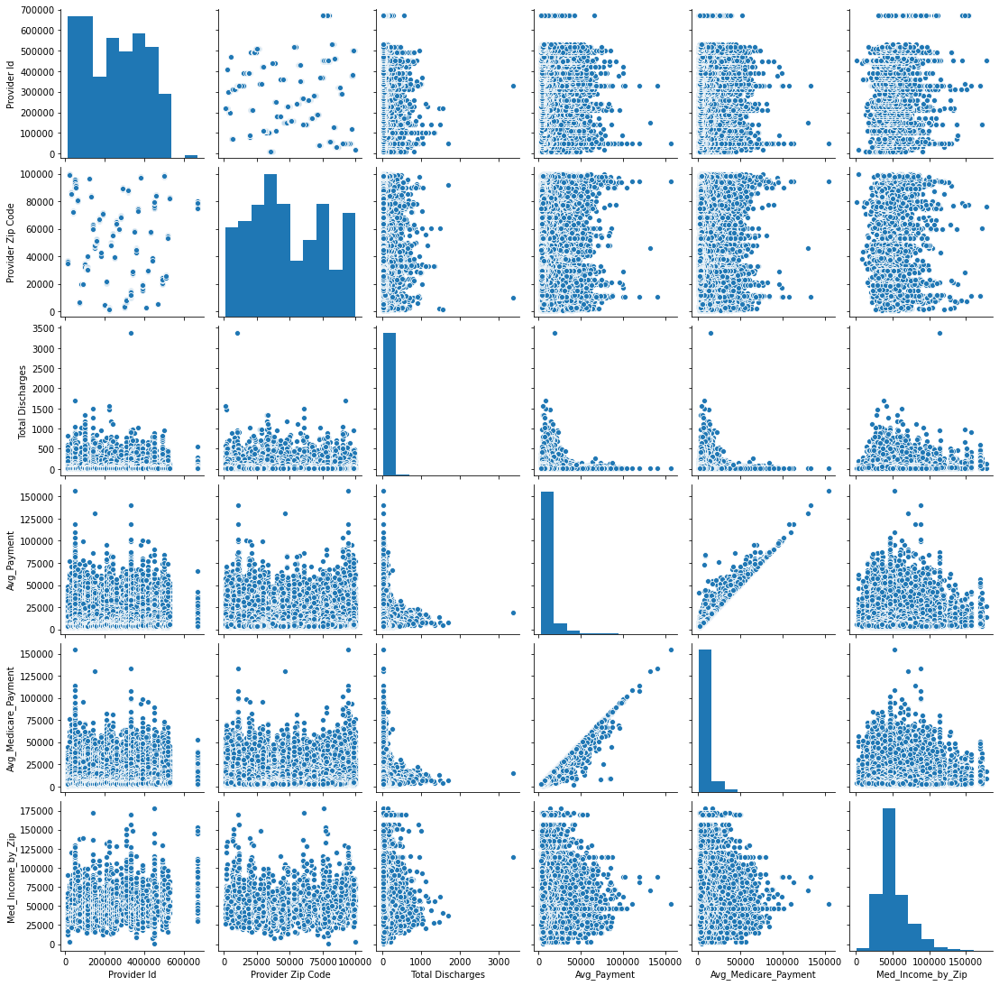

In [9]:
# Having a first glance at the data shows that the distribution of 'avg_payment' is right skewed indicating outlier values
# Plus, there seems to be some hospitals with relatively lower discharge despite high avg.payment
sns.pairplot(df) 

## Feature Engineering (New Feature Creation)

In [10]:
# Feature 1-2
# Grouping DRG Definition and State information to get median and standard deviation values
# If there is a state-wise abnormality in any DRG section these features will capture this by measuring median and standard deviation
cols_to_use = ['DRG Definition','Provider State','Avg_Payment']
cols_to_group = ['DRG Definition','Provider State']

ft1 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).median()).rename(columns = {'Avg_Payment':'Avg_Payment_DRG_State'})
df = ft1.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

ft2 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group).std()).rename(columns = {'Avg_Payment':'Avg_Payment_DRG_State_Std'}).reset_index()
df = ft2.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

In [11]:
# Feature 3-4-5
# Grouping DRG Definition and Zip Code to get median, minimum and maximum values
# Compared to state-wise information, zip code returns a more micro perspective and with minimum,maximum and median value aggregations,this could help flagging outlying information 
cols_to_use = ['DRG Definition','Provider Zip Code','Avg_Payment']
cols_to_group = ['DRG Definition','Provider Zip Code']

ft3 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).median()).rename(columns = {'Avg_Payment':'Avg_Payment_DRG_Zip'})
df = ft3.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

ft4 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).min()).rename(columns = {'Avg_Payment':'Avg_Payment_DRG_Zip_Min'})
df = ft4.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

ft5 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).max()).rename(columns = {'Avg_Payment':'Avg_Payment_DRG_Zip_Max'})
df = ft5.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

In [12]:
# Now I am gonna break it down based on Hospitals.There are 3337 hospitals in the dataset
df['Provider Id'].nunique()

3337

In [13]:
# Feature 6-7-8
# Grouping Hospitals(Provider ID) and Zip Code to get median, standard deviation  and maximum values
# Now, instead of a DRG-wise fraud detection, I focused on hospital-wise possible abnormalities. 
cols_to_group = ['Provider Id','Provider Zip Code']
cols_to_use = ['Provider Id','Avg_Payment','Provider Zip Code']

ft6 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).median()).rename(columns = {'Avg_Payment':'Avg_Payment_Hospital_Zip'})
df = ft6.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

ft7 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group).std()).rename(columns = {'Avg_Payment':'Avg_Payment_Hospital_Zip_Std'}).reset_index()
df = ft7.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

ft8 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).max()).rename(columns = {'Avg_Payment':'Avg_Payment_Hospital_Zip_Max'})
df = ft8.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

In [14]:
# Feature 9
# Average Household Income by Hospital and Zip Code 
# Income needs to be go in line with the avg.payment. Otherwise, a suspicious environment would emerge
cols_to_group = ['Provider Id']
cols_to_use = ['Provider Id','Med_Income_by_Zip']

ft9 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).mean()).rename(columns = {'Med_Income_by_Zip':'Avg_ Hospital_Zip_HH_Income'})
df = ft9.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

In [15]:
# Feature 10 
# By getting the average hospital discharges I target at spotting hospitals with extreme values of discharges
cols_to_group = ['Provider Id']
cols_to_use = ['Provider Id',' Total Discharges ']

ft10 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).mean()).rename(columns = {' Total Discharges ':'Avg_ Hospital_Discharges'})
df = ft10.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

Text(0.5, 1.0, 'Correlation Heatmap')

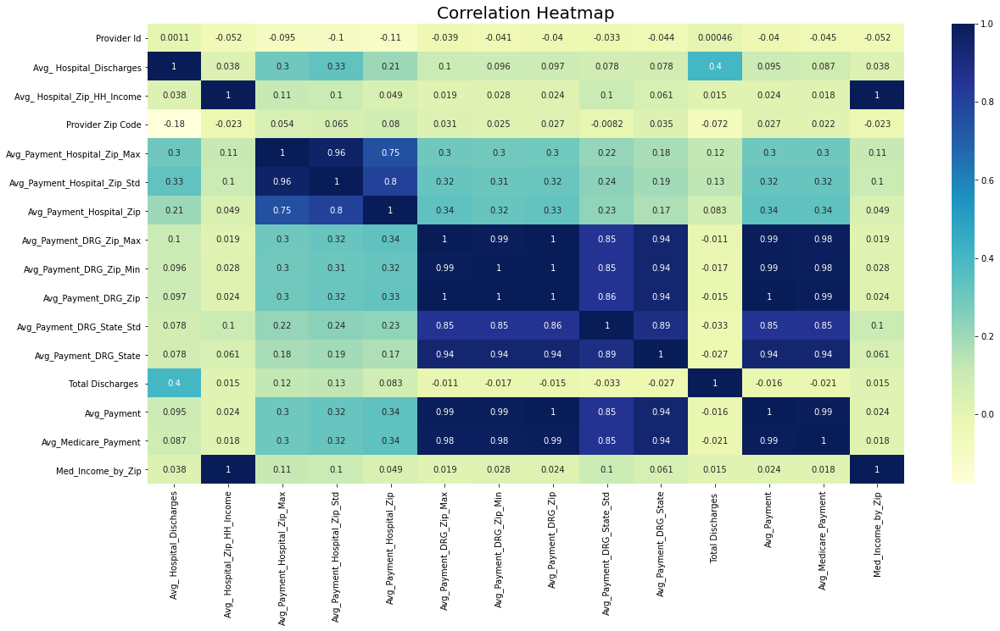

In [16]:
# Exploring the correlation heatmap following feature engineering operations
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
# Compute the correlation matrix
drops = ['Provider Id', 'Provider Zip Code']
corr = df.select_dtypes(include=numerics).corr().drop(drops,axis=1)

plt.figure(figsize=(20,10))
sns.heatmap(corr,annot=True,cmap='YlGnBu', square=False)
plt.title('Correlation Heatmap',size=20)

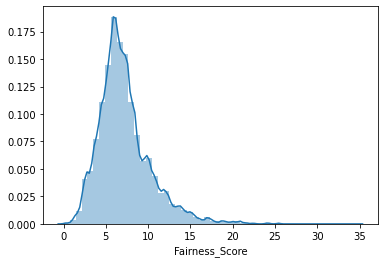

In [17]:
# Feature 11
# The ratio of Avg_Payment to Household Income by the Zip Code could be a significant indicator in terms 'fairness'
# I will call this new feature 'Fairness_Score' - the more the healthier and vice versa
df['Fairness_Score'] = df['Med_Income_by_Zip'] / df['Avg_Payment_Hospital_Zip']
sns.distplot(df['Fairness_Score'])

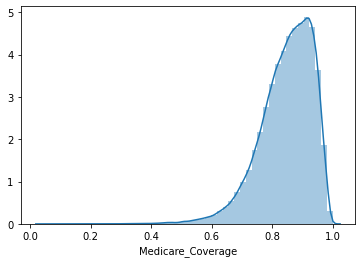

In [18]:
# Feature 12
# The ratio of Avg_Medicare_Payment to Avg_Payment could be a significant indicator in terms 'Insurance Coverage Rate'
# I will call this new feature 'Social_Score' 
df['Medicare_Coverage'] = df['Avg_Medicare_Payment'] / df['Avg_Payment']
sns.distplot(df['Medicare_Coverage'])

In [19]:
# Feature 13
# Total count of state-wise treatments by Grouping DRG Definitions. If a specific state extremely treated more patients in a specific DRG that might raise a flag
cols_to_group = ['Provider State','DRG Definition']
cols_to_use = ['Provider State','DRG Definition','Provider Id']

ft13 = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).count()).rename(columns = {'Provider Id':'Treatment_Count_by_DRG'})
df = ft13.merge(df,how='left',left_on=cols_to_group, right_on=cols_to_group)

## INSIGHT EXTRACTION FROM CREATED FEATURES

In [20]:
# 3D Visualization based on Income,Avg_Payment and Medicare Coverage rate flags multiple outliers which need further investigation
fig = px.scatter_3d(df, x='Medicare_Coverage', y='Med_Income_by_Zip', z='Avg_Payment_Hospital_Zip',color = 'Provider State')          
fig.show()

In [21]:
# Results are even more interesting when breaking it down to treatments having over 99% medicare coverage
df_medicare = df[df['Medicare_Coverage'] > 0.99]
fig = px.scatter_3d(df_medicare, x='Medicare_Coverage', y='Med_Income_by_Zip', z='Avg_Payment_Hospital_Zip',color = 'Provider State')          
fig.show()

Text(0.5, 1.0, 'Household Income vs Avg. Payment by Zip Code ')

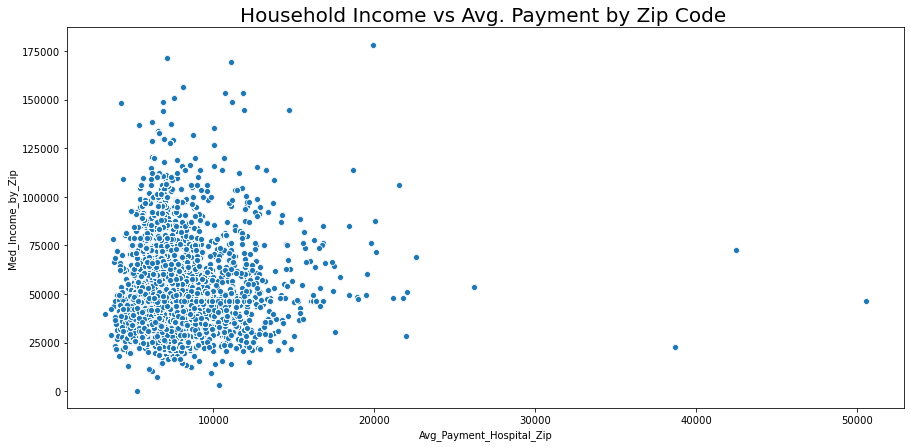

In [22]:
# Hospitals with disproportionate avg_payment vs median household income are usual suspects for fraud 
plt.figure(figsize=(15,7))
sns.scatterplot(x='Avg_Payment_Hospital_Zip',y='Med_Income_by_Zip',data=df)
plt.title('Household Income vs Avg. Payment by Zip Code ',size=20)

Text(0.5, 1.0, 'Avg Payment by DRG Definitions')

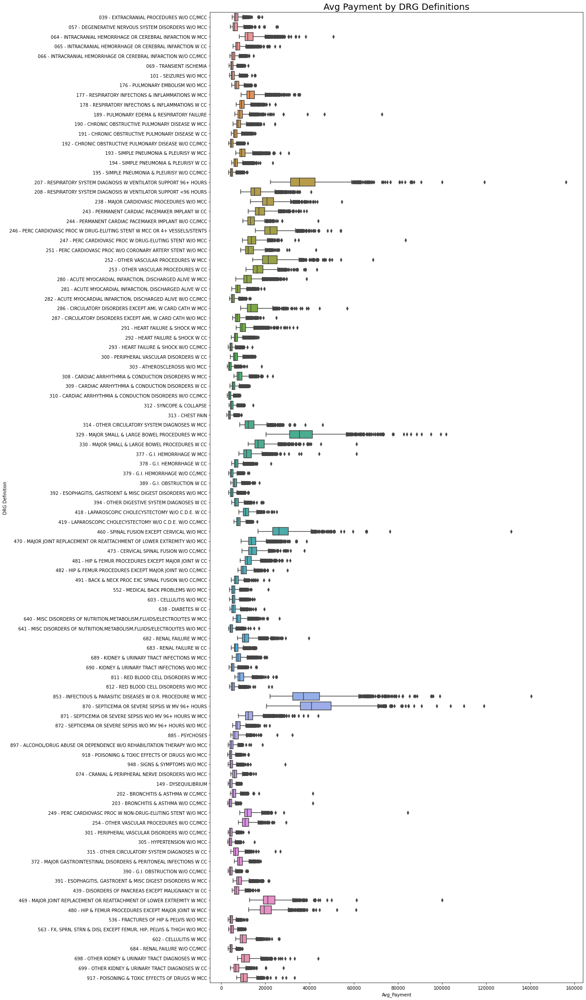

In [23]:
# Several DRG's have relatively higher variance and this needs to be further inspected 
plt.figure(figsize=(15,40))
sns.boxplot(x='Avg_Payment',y='DRG Definition',data=df)
plt.title('Avg Payment by DRG Definitions',size=20)

Text(0.5, 1.0, 'Top 10 City by Highest Varience in Avg.Payment')

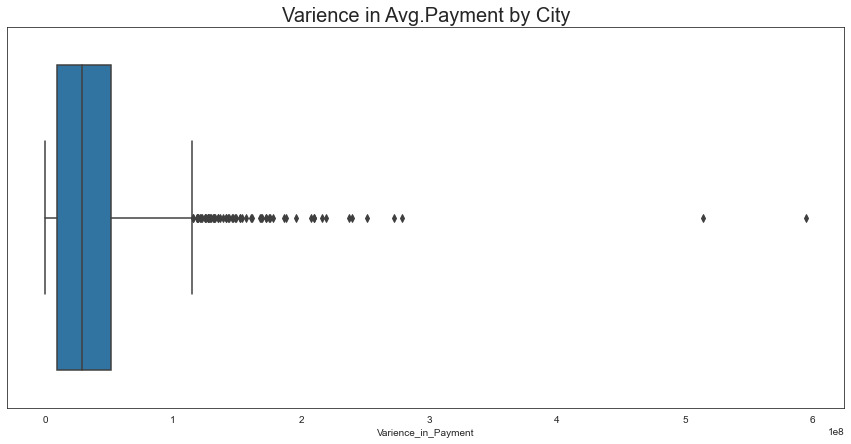

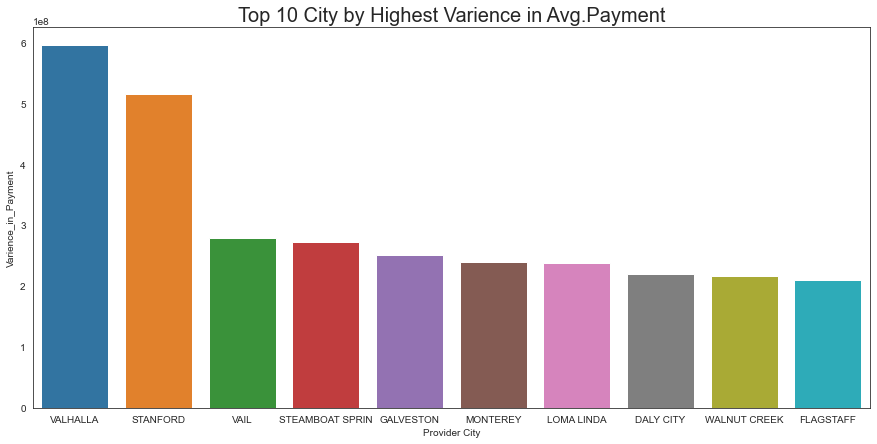

In [24]:
# Looking through the varience in Avg.Payment city-wise, especially Valhalla and Standford outlies with their extreme variance levels
cols_to_group = ['Provider City']
cols_to_use = ['Provider City','Avg_Payment']
varience = pd.DataFrame(df[cols_to_use].groupby(cols_to_group, as_index=False).var()).rename(columns = {'Avg_Payment':'Varience_in_Payment'}).dropna()
plt.figure(figsize=(15,7))
sns.set_style("white")
sns.boxplot(varience.Varience_in_Payment)
plt.title('Varience in Avg.Payment by City',size=20)
# Vısualizing top 10 cities in terms of varience in avg. payment
plt.figure(figsize=(15,7))
sns.set_style("white")
top10 = varience.sort_values(by='Varience_in_Payment',ascending=False).head(10)
sns.barplot(y='Varience_in_Payment',x='Provider City',data=top10)
plt.title('Top 10 City by Highest Varience in Avg.Payment',size=20)

## PREPARING DATA BEFORE MODELING (COLLINEARITY & STANDARDIZATION)

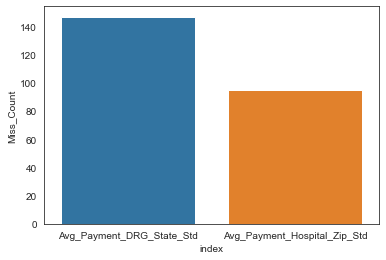

In [25]:
# Missing Value Detection after feature engineering
df_mis = pd.DataFrame(df.isnull().sum()).reset_index().sort_values(by=0,ascending=False).rename(columns={0:'Miss_Count'})
sns.barplot(x= 'index', y = 'Miss_Count', data = df_mis[df_mis['Miss_Count']>0])

In [26]:
# Quite low level of missing values only in two recently created feature. Median value imputation will be executed
df = df.fillna(df.median())

In [27]:
# Define Categorical Variables to drop
# I already processed categorical variables into new features such as State, DRG and Hospital by groupby-aggregating functions 
drops = ['Provider State','DRG Definition','Provider Zip Code','Provider Id','Provider City','Treatment_Count_by_DRG']
df_final = df.drop(drops,axis=1)

Text(0.5, 1.0, 'Correlation Heatmap')

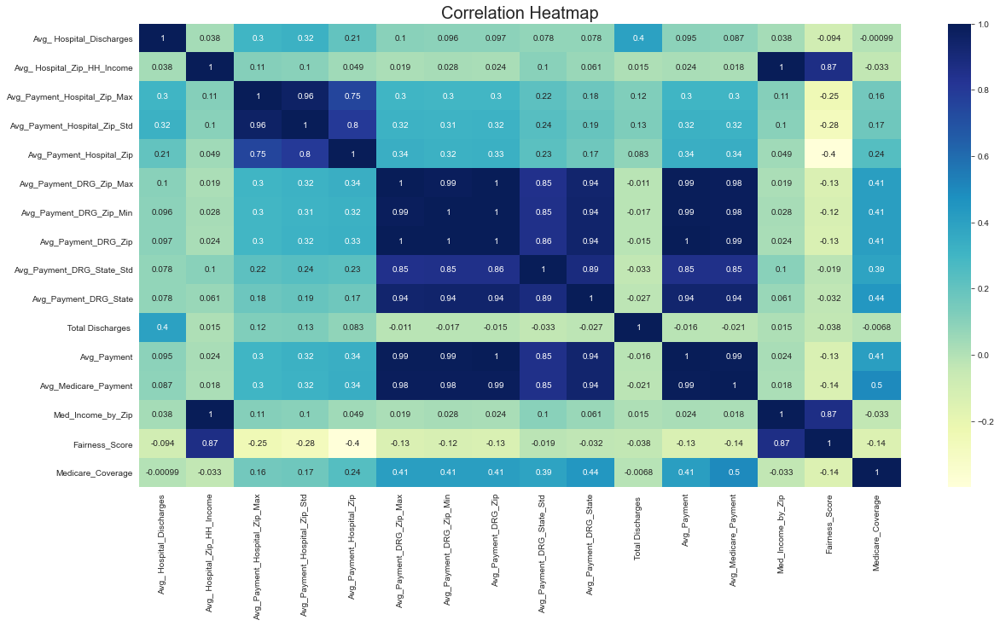

In [28]:
# Heatmap reveals there is multicollinearity in the dataset and this needs to be eliminated
corr = df_final.corr()
plt.figure(figsize=(20,10))
sns.heatmap(corr,annot=True,cmap='YlGnBu', square=False)
plt.title('Correlation Heatmap',size=20)

#### Elimination of Multicollinear features based on Variance inflation factor score. My threshold point will be 10

In [29]:
def calculate_vif_(X, thresh=10):
    variables = list(range(X.shape[1]))
    dropped = True
    while dropped:
        dropped = False
        vif = [variance_inflation_factor(X.iloc[:, variables].values, ix)
               for ix in range(X.iloc[:, variables].shape[1])]

        maxloc = vif.index(max(vif))
        if max(vif) > thresh:
            print('dropping \'' + X.iloc[:, variables].columns[maxloc] +
                  '\' at index: ' + str(maxloc))
            del variables[maxloc]
            dropped = True

    print('Remaining variables:')
    print(X.columns[variables])
    return X.iloc[:, variables].head(3)
    df_final = X.iloc[:, variables]

calculate_vif_(df_final, thresh=10)

C:\Users\Public\anaconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:193: RuntimeWarning:

divide by zero encountered in double_scalars



dropping 'Avg_ Hospital_Zip_HH_Income' at index: 1
dropping 'Avg_Payment_DRG_Zip' at index: 6
dropping 'Avg_Payment' at index: 9
dropping 'Avg_Payment_DRG_Zip_Min' at index: 5
dropping 'Avg_Payment_Hospital_Zip_Std' at index: 2
dropping 'Avg_Payment_DRG_Zip_Max' at index: 3
dropping 'Med_Income_by_Zip' at index: 7
dropping 'Avg_Payment_Hospital_Zip' at index: 2
dropping 'Avg_Payment_DRG_State' at index: 3
dropping 'Medicare_Coverage' at index: 6
Remaining variables:
Index(['Avg_ Hospital_Discharges', 'Avg_Payment_Hospital_Zip_Max',
       'Avg_Payment_DRG_State_Std', ' Total Discharges ',
       'Avg_Medicare_Payment', 'Fairness_Score'],
      dtype='object')


,Avg_ Hospital_Discharges,Avg_Payment_Hospital_Zip_Max,Avg_Payment_DRG_State_Std,Total Discharges,Avg_Medicare_Payment,Fairness_Score
0,25.038462,40029.12,1363.849184,23,6413.78,5.218083
1,34.381579,61300.63,1363.849184,11,8081.54,0.313740
2,34.381579,61300.63,5423.494870,34,16696.61,0.313740


In [30]:
selected = ['Avg_ Hospital_Discharges', 'Avg_Payment_Hospital_Zip_Max','Avg_Payment_DRG_State_Std', ' Total Discharges ',     
       'Avg_Medicare_Payment', 'Fairness_Score']
df_final = df_final[selected]

Text(0.5, 1.0, 'Correlation Heatmap after elimination')

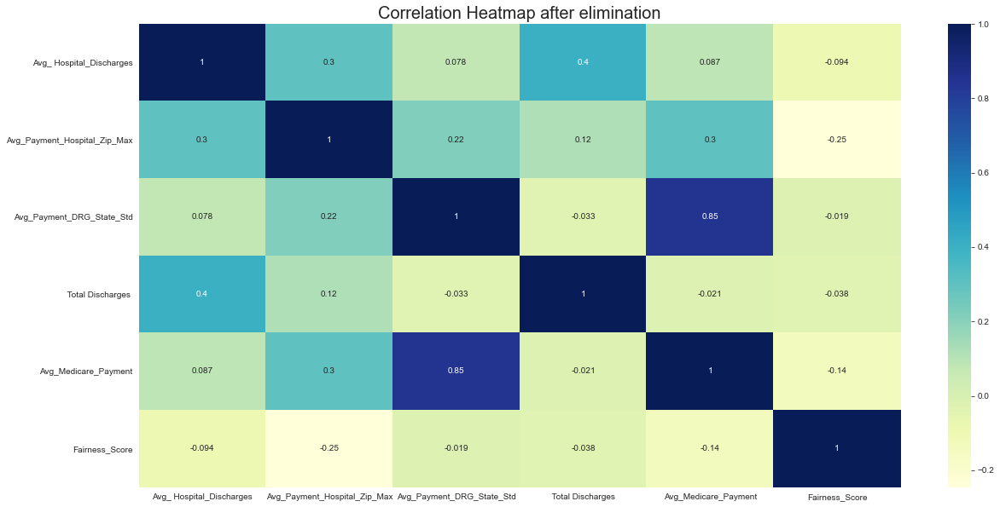

In [31]:
# Heatmap after multicollinearity
corr = df_final.corr()
plt.figure(figsize=(20,10))
sns.heatmap(corr,annot=True,cmap='YlGnBu', square=False)
plt.title('Correlation Heatmap after elimination',size=20)

In [32]:
# Since we don't have any y variable I use simple pandas 'sample' funtion to randomly split the data

# randomly sequence the data
df_final = df_final.sample(frac=1, replace=True, random_state=111)

# train will be 70% and the test will be 30%
train_row_count = round(df_final.shape[0]*0.7)
train  = df_final.iloc[:train_row_count,:]
test  = df_final.iloc[train_row_count:,:]

print(train.shape)
print(test.shape)
df_final.shape[0]

(114146, 6)
(48919, 6)


163065

In [33]:
#Standardize Train and Test sets
mms_t = MinMaxScaler()
mms_t.fit(train)
train_s = pd.DataFrame(mms_t.transform(train))

mms_t = MinMaxScaler()
mms_t.fit(test)
test_s = pd.DataFrame(mms_t.transform(test))

## OUTLIER DETECTION WITH KNN

The unsupervised k-NN method computes the distance of an observation, called Euclidean distance, to other observations. Because an isolated data point has a large distance to other observations, it can be seen as an outlier.
The KNN algorithm assumes that similar things exist in close proximity. In other words, similar things are near to each other.
In KNN, computing the distances to neighbors does not require the target variable.

#### Advantages
- The algorithm is simple and easy to implement.
- There’s no need to build a model, tune several parameters, or make additional assumptions.
- The algorithm is versatile. It can be used for classification, regression, and search (as we will see in the next section).

#### Disadvantages
- The algorithm gets significantly slower as the number of examples and/or predictors/independent variables increase.
- Tend to be very sensitive to outliers.

In [34]:
from pyod.models.knn import KNN

In [35]:
# Lets look into standardized train dataset before training 
train_s.head()

,0,1,2,3,4,5
0,0.041198,0.162557,0.112097,0.024021,0.058027,0.241898
1,0.036751,0.276016,0.104175,0.000593,0.071088,0.189290
2,0.171790,0.215549,0.030503,0.119514,0.026510,0.149646
3,0.075190,0.336643,0.054652,0.000890,0.050421,0.314289
4,0.042224,0.426135,0.194760,0.005635,0.137641,0.279359


In [36]:
# train the kNN detector
clfknn = KNN()
clfknn.fit(train_s)

KNN(algorithm='auto', contamination=0.1, leaf_size=30, method='largest',
  metric='minkowski', metric_params=None, n_jobs=1, n_neighbors=5, p=2,
  radius=1.0)

In [37]:
# Based on the prediction function of KNN, ~10 percent of the data labeled differently
label = clfknn.predict(test_s)
unique, counts = np.unique(label, return_counts=True)
dict(zip(unique, counts))

{0: 37854, 1: 11065}

In [38]:
# Convert result into dataframe format 
anomaly_score = clfknn.decision_function(test_s)
anomaly_score = pd.DataFrame(anomaly_score).rename(columns={0:'Anomaly_Score'})

In [39]:
# To prevent KNN's sensitivity to outliers, I executed 10 different scenarios and take their averages

from pyod.models.combination import aom, moa, average, maximization
from pyod.utils.utility import standardizer

# Standardize data
X_train_norm, X_test_norm = standardizer(train_s, test_s)

# Test a range of k-neighbors from 5 to 250. 
n_clf = 10
k_list = [5, 10, 20, 50, 100, 125, 150, 175, 200, 250]

# Just prepare data frames so we can store the model results
train_scores = np.zeros([train_s.shape[0], n_clf])
test_scores = np.zeros([test_s.shape[0], n_clf])
train_scores.shape

# Modeling
for i in range(n_clf):
    k = k_list[i]
    clfknn = KNN(n_neighbors=k, method='largest')
    clfknn.fit(X_train_norm)

    # Store the results in each column:
    train_scores[:, i] = clfknn.decision_scores_
    test_scores[:, i] = clfknn.decision_function(X_test_norm) 
    
# Decision scores have to be normalized before combination
train_scores_norm, test_scores_norm = standardizer(train_scores,test_scores)

C:\Users\Public\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning:

The sklearn.utils.testing module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.utils. Anything that cannot be imported from sklearn.utils is now part of the private API.



#### I will aggregate each different KNN result by average

In [40]:
average(test_scores_norm)

array([-0.42819794,  1.070153  ,  0.0335996 , ..., -0.06035261,
       -0.2420754 ,  6.08834984])

In [41]:
# Combination by average 
anomaly_score = average(test_scores_norm)

# Convert result into dataframe format 
anomaly_score = pd.DataFrame(anomaly_score).rename(columns={0:'Anomaly_Score'})

Text(0.5, 1.0, 'Zoom in Version')

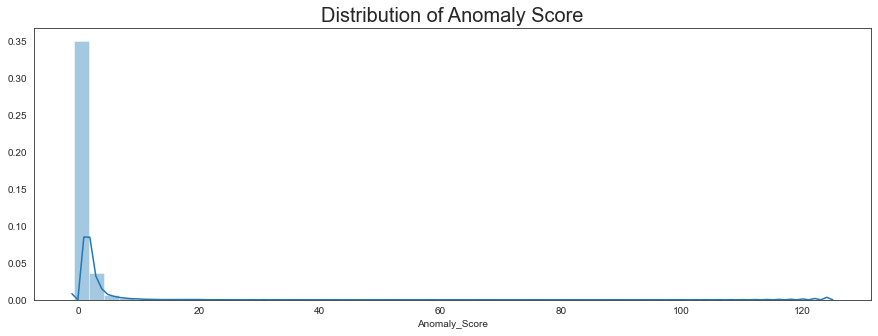

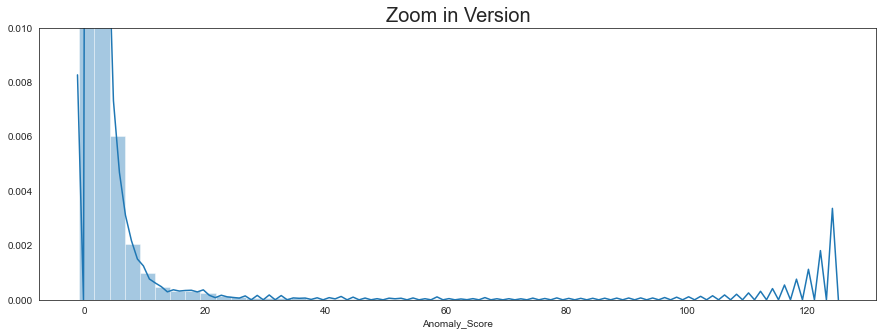

In [42]:
# Exploring distribution of anomaly scores to determine cut-off point
plt.figure(figsize=(15,5))
sns.distplot(anomaly_score['Anomaly_Score'])
plt.title('Distribution of Anomaly Score',size=20)
# Zoom in to better spot anomalies
plt.figure(figsize=(15,5))
sns.distplot(anomaly_score['Anomaly_Score'])
plt.ylim(0,0.01)
plt.title('Zoom in Version',size=20)

In [43]:
# I write a function to label values above 8 as 'Fraud'
def detection(x):
    if x['Anomaly_Score'] > 8:
        var = 'Anomaly'
    else:
        var = 'Normal'
    return var
anomaly_score['Result'] = anomaly_score.apply(detection,axis=1)

# 1 out of every 100 transactions turn out to be potentially fraud
summary = anomaly_score.groupby('Result').count().reset_index()
summary['Percentage'] = round(summary['Anomaly_Score'] / sum(summary['Anomaly_Score']),2)
summary

,Result,Anomaly_Score,Percentage
0,Anomaly,478,0.01
1,Normal,48441,0.99


In [44]:
# Now I go deeper into summary statistics through comparing this result with original features
test_final = pd.concat([test.reset_index().drop('index',axis=1),anomaly_score],axis=1).drop('Anomaly_Score',axis=1)
final_statistics =  test_final.groupby('Result').mean().reset_index()
round(final_statistics,1)

,Result,Avg_ Hospital_Discharges,Avg_Payment_Hospital_Zip_Max,Avg_Payment_DRG_State_Std,Total Discharges,Avg_Medicare_Payment,Fairness_Score
0,Anomaly,90.5,47011.0,2968.6,347.8,13192.6,7.2
1,Normal,42.3,37560.0,1894.9,39.6,8448.2,7.2


In [45]:
# I transformed the summary table to be able execute an hollistic visualization with facetgrids
sum_plot =final_statistics.melt(id_vars=['Result']).reset_index()

#### After visualizing summary statistics (below), it can be clearly seen that 5 out of 6 features are widely different from each other

#### Key Observations
- Average Hospital and total hospital discharges extremely differentiates between normal and abnormal groups. This might be a result of unnecessary or fake treatments
- Average medicare payments are significantly varied which might be the indication of exploiting medicare system
- Abnormal group's standard deviation in Average payment by each DRG is almost 50% more than that of normal group. This could be the result of fradulent procedures followed for these treatments.   

Text(0.5, 0.98, 'KNN OUTLIER DETECTION RESULTS - MEAN STATISTICS BY EACH FEATURE')

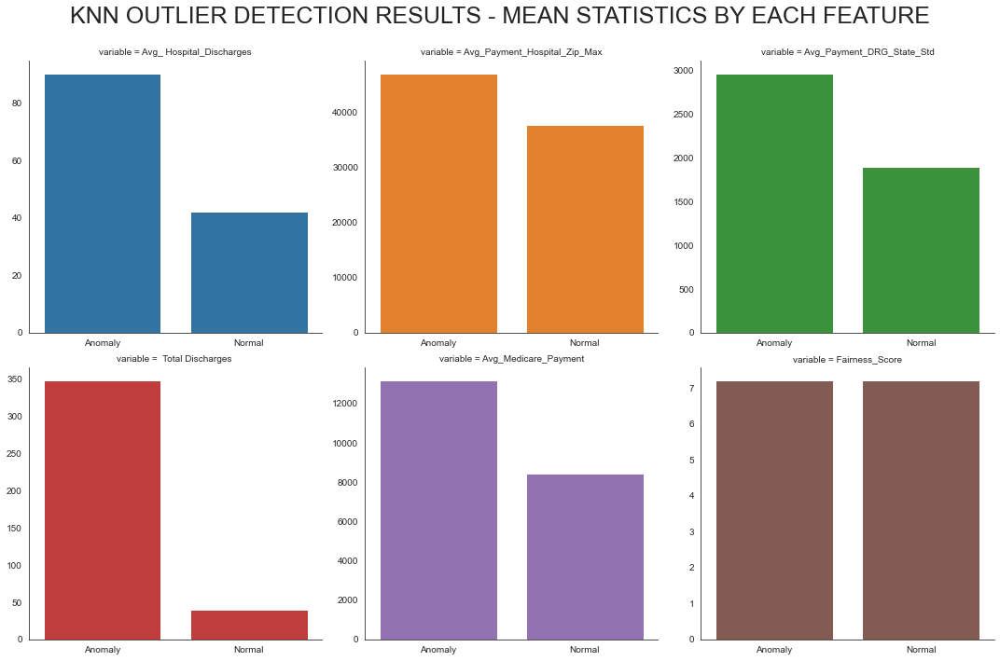

In [46]:
g = sns.FacetGrid(sum_plot, col="variable",hue='variable',col_wrap=3, sharex=False,sharey=False,height=5)
g.map_dataframe(sns.barplot,x= "Result",y= "value")
plt.subplots_adjust(top=0.9)
g.fig.suptitle('KNN OUTLIER DETECTION RESULTS - MEAN STATISTICS BY EACH FEATURE',size=25)

## OUTLIER DETECTION WITH PCA

Principal Component Analysis, which is frequently abbreviated to PCA, is an established technique in machine learning. PCA is frequently used in exploratory data analysis because it reveals the inner structure of the data and explains the variance in the data.

PCA works by analyzing data that contains multiple variables. It looks for correlations among the variables and determines the combination of values that best captures differences in outcomes. These combined feature values are used to create a more compact feature space called the principal components.

For anomaly detection, each new input is analyzed, and the anomaly detection algorithm computes its projection on the eigenvectors, together with a normalized reconstruction error. The normalized error is used as the anomaly score. The higher the error, the more anomalous the instance is.

In [47]:
from pyod.models.pca import PCA

In [48]:
# train the kNN detector
clfpca = PCA()
clfpca.fit(train_s)

PCA(contamination=0.1, copy=True, iterated_power='auto', n_components=None,
  n_selected_components=None, random_state=None, standardization=True,
  svd_solver='auto', tol=0.0, weighted=True, whiten=False)

In [49]:
# Based on the prediction function of PCA, ~10 percent of the data labeled differently
label = clfpca.predict(test_s)
unique, counts = np.unique(label, return_counts=True)
dict(zip(unique, counts))

{0: 40021, 1: 8898}

In [50]:
# Convert result into dataframe format for visualization
anomaly_score = clfpca.decision_function(test_s)
anomaly_score = pd.DataFrame(anomaly_score).rename(columns={0:'Anomaly_Score'})

Text(0.5, 1.0, 'Zoom in Version')

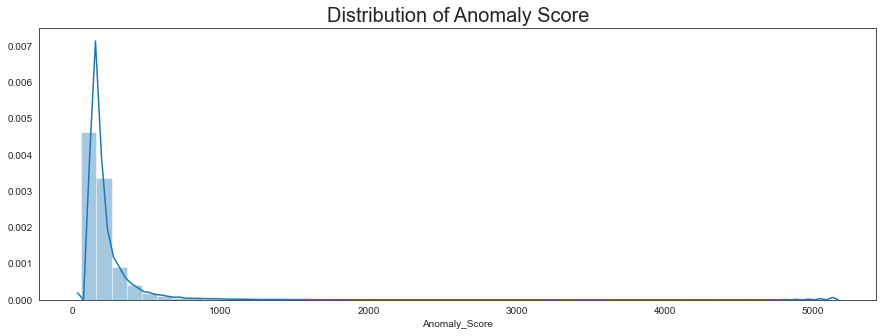

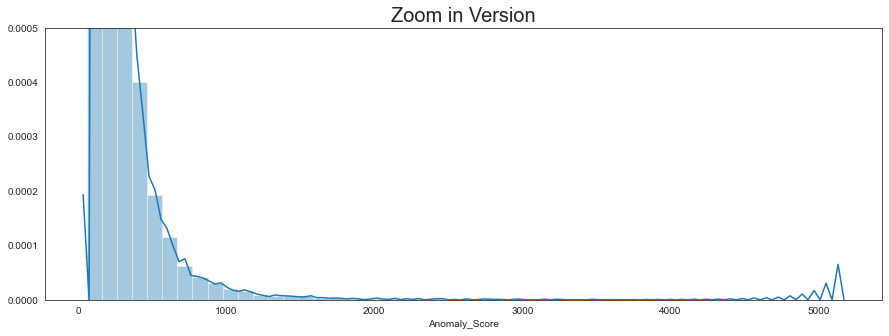

In [51]:
# Exploring distribution of anomaly scores to determine cut-off point
plt.figure(figsize=(15,5))
sns.distplot(anomaly_score['Anomaly_Score'])
plt.title('Distribution of Anomaly Score',size=20)
# Zoom in to better spot anomalies
plt.figure(figsize=(15,5))
sns.distplot(anomaly_score['Anomaly_Score'])
plt.ylim(0,0.0005)
plt.title('Zoom in Version',size=20)

In [52]:
# I write a function to label value above 1000 as 'Fraud'
def detection(x):
    if x['Anomaly_Score'] > 1000:
        var = 'Anomaly'
    else:
        var = 'Normal'
    return var

# Results show quite similar compared to that of KNN's
anomaly_score['Result'] = anomaly_score.apply(detection,axis=1);anomaly_score.groupby('Result').count().reset_index()

,Result,Anomaly_Score
0,Anomaly,416
1,Normal,48503


In [53]:
# As it is in KNN detection, roughly 1 out of every 100 transactions turn out to be potentially fraud
summary = anomaly_score.groupby('Result').count().reset_index()
summary['Percentage'] = round(summary['Anomaly_Score'] / sum(summary['Anomaly_Score']),2)
summary

,Result,Anomaly_Score,Percentage
0,Anomaly,416,0.01
1,Normal,48503,0.99


In [54]:
# Now I go deeper into summary statistics through comparing PCA result with original features
test_final = pd.concat([test.reset_index().drop('index',axis=1),anomaly_score],axis=1).drop('Anomaly_Score',axis=1)
final_statistics_pca =  test_final.groupby('Result').mean().reset_index()
round(final_statistics_pca,1)

,Result,Avg_ Hospital_Discharges,Avg_Payment_Hospital_Zip_Max,Avg_Payment_DRG_State_Std,Total Discharges,Avg_Medicare_Payment,Fairness_Score
0,Anomaly,88.4,44029.2,2482.2,376.2,11268.1,7.1
1,Normal,42.4,37597.7,1900.5,39.7,8470.8,7.2


In [55]:
# I transformed the summary table to be able execute an hollistic visualization with facetgrids
sum_plot_pca =final_statistics_pca.melt(id_vars=['Result']).reset_index()

#### After visualizing summary statistics (below), it can be clearly seen that 5 out of 6 features are widely different from each other

#### Key Observations
- Average Hospital and total hospital discharges extremely differentiates between normal and abnormal groups. This might be a result of unnecessary or fake treatments
- Average medicare payments are significantly varied which might be the indication of exploiting medicare system
- Abnormal group's standard deviation in Average payment by each DRG is almost 50% more than that of normal group. This could be the result of fradulent procedures followed for these treatments.   

Text(0.5, 0.98, 'PCA OUTLIER DETECTION RESULTS - MEAN STATISTICS BY EACH FEATURE')

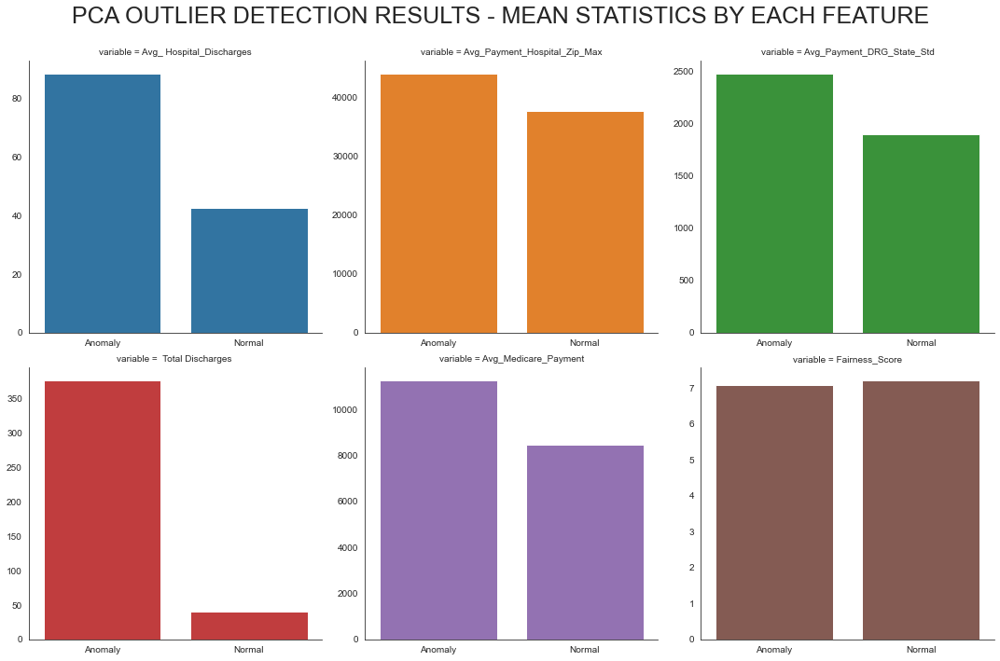

In [56]:
g = sns.FacetGrid(sum_plot_pca, col="variable",hue='variable',col_wrap=3, sharex=False,sharey=False,height=5)
g.map_dataframe(sns.barplot,x= "Result",y= "value")
plt.subplots_adjust(top=0.9)
g.fig.suptitle('PCA OUTLIER DETECTION RESULTS - MEAN STATISTICS BY EACH FEATURE',size=25)

## COMPARISON (KNN vs PCA)

In [57]:
# Created a combined data with KNN and PCA outlier detection summary statistics tables
sum_plot['Method'] = 'KNN'
sum_plot_pca['Method'] = 'PCA'
comparison = pd.concat([sum_plot,sum_plot_pca],axis=0)

#### Both KNN and PCA anomaly detections exhibit quite similar results.To choose one, I would most probably select PCA, given the fact that it is computation-wise faster than KNN 

Text(0.5, 0.98, 'OUTLIER DETECTION RESULTS KNN VS PCA - MEAN STATISTICS BY EACH FEATURE')

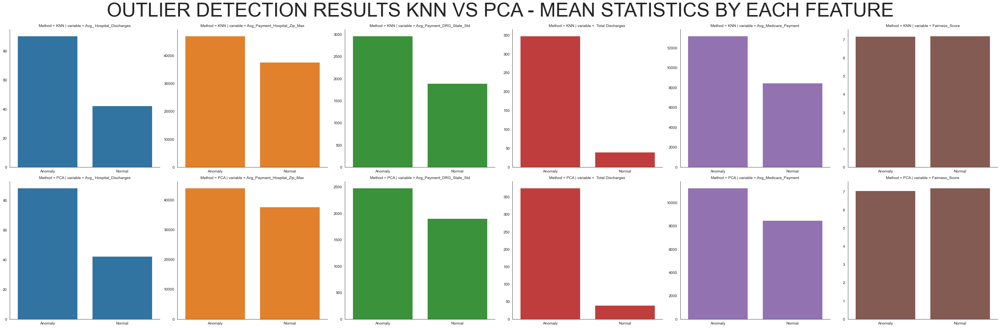

In [58]:
splot = sns.FacetGrid(comparison,row='Method',col="variable",hue='variable', sharex=False,sharey=False,height=6)
splot.map_dataframe(sns.barplot,x= "Result",y= "value")
plt.subplots_adjust(top=0.9)
splot.fig.suptitle('OUTLIER DETECTION RESULTS KNN VS PCA - MEAN STATISTICS BY EACH FEATURE',size=50)